# **ACTIVIDAD MIDTERM**

Yuna Chung A01709043

### **DESCRIPCIÓN**

Felicidades! Eres el orgulloso propietario de 5 robots nuevos y un almacén lleno de cajas. El dueño anterior del almacén lo dejó en copmleto desorden, por lo que depende de tus robots organizar las cajas en algo parecido al orden y convertirlo en un negocio exitoso.

Cada robot está equipado con ruedas omnidireccionales y, por lo tanto, puede conducir en las cuatro direcciones.Pueden recoger cajas en celdas de cuadrícula adyacentes con sus manipuladores, luego llevarlas a otra ubicación e incluso construir pilas de hasta cinco cajas. Todos los robots están equipados con la tecnología de sensores más nueva que les permite recibir datos de sensores de las cuatro celdas adyacentes. Por tanto, es fácil distinguir si un cmapo está libre, es una pared, contiene una pila de cajas (ya cuantas cajas hay en la pila) o está ocupado por otro robot. Los robots también tienen sensores de presión equipados que les indican si llevan una caja en ese momento.

Lamentablemente, tu presupuesto resultó insuficiente para adquirir un software de gestión de agentes múltiples de última generación. Pero eso no debería ser un gran problema ... ¿verdad? Tu tarea es enseñar a sus robots cómo ordenar su almacén. La organización de los agentes depende de ti, siempre que todas las cajas terminen en pilas ordenas de cinco.

#### **PUNTOS A CONSIDERAR**

- La semilla para generación de números aleatorios será 67890
- El almacén es 20 x 20 celdas
- Al inicio de la simulación, tu solución deberá colocar 200 cajas repartidas en grupos de 1 a 3 cajas en posiciones aleatorias
- Todos los robots empiezan en posiciones aleatorias vacías. Y, sólo puede haber un robot por celda
- La simulación termina cuando todas las cajas se encuentra apiladas en pilas de exactamente 5 cajas

#### **¿QUÉ DEBES ENTREGAR**

Un cuaderno de Jupyter Notebook conteniendo un reporte de la actividad. El cuaderno deberá contener:

- Código fuente documentado.
- Descripción detallada de la estrategia y los mecanismos utilizados en tu solución.
- Una visualización que permita ver los diferentes pasos de la simulación.
- El número de pasos necesarios para terminar la simulación.
- ¿Existe una forma de reducir el número de pasos utilizados? Si es así, ¿cuál es la estrategia que se tendría en implementar?

### **CRITERIOS DE EVALUACIÓN**

Los criterios que se utilizarán para evaluar sus soluciones y seleccionar a los tres primeros ganadores son los siguientes:

- Aplicación original, innovadora y efectiva de algoritmos computacionales para resolver problemas específicos
- El rendimiento de la implementación. El rendimiento de la implementación se medirá en función los pasos necesarios para terminar la simulación
- La cliadad de la descripción de análisis, diseño e implementación del sistema multiagente, la elegancia de su diseño e implmenetación

In [11]:
from mesa import Agent, Model

from mesa.space import MultiGrid
from mesa.space import SingleGrid

from mesa.time import SimultaneousActivation

from mesa.datacollection import DataCollector

%matplotlib inline
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.animation as animation
plt.rcParams["animation.html"] = "jshtml"
matplotlib.rcParams['animation.embed_limit'] = 2**128

import numpy as np
import pandas as pd
import random
import math

import seaborn as sns

In [12]:
class StorageAgent(Agent):
    def __init__(self, id, model):
        super().__init__(id, model)
        self.hands_full = False
        self.count_drop = 0
        self.total_drop = 5

        self.random.seed(67890)

    def step(self):
        remaining_boxes = 40 - self.model.sum_stack()

        if remaining_boxes == 1:
            self.last_unit()

        if self.hands_full:
            self.drop_unit()
        else:
            self.pickup_unit()

    def move(self):
        close_neighbors = self.model.grid.get_neighborhood(self.pos, 
                                                          moore = False,
                                                          include_center = False
        )

        is_possible = [step for step in close_neighbors if self.model.grid.is_cell_empty(step)]

        if is_possible:
            new_position = self.random.choice(is_possible)
            self.model.grid.move_agent(self, new_position)

    def pickup_unit(self):
        neighbors = self.model.grid.get_neighborhood(self.pos, 
                                                     moore = False, 
                                                     include_center = False)
        for neighbor_pos in neighbors:
            x, y = neighbor_pos
            if 0 < self.model.floor[x, y] < 5:
                self.model.floor[x, y] -= 1
                self.hands_full = True
                break
        self.move()

    def last_unit(self):
        if self.hands_full:
            self.drop_unit()
        else:
            self.pickup_last()

    def pickup_last(self):
        neighbors = self.model.grid.get_neighborhood(
            self.pos, moore=False, include_center=False)
        for neighbor_pos in neighbors:
            x, y = neighbor_pos
            if self.model.floor[x, y] == 1:
                self.model.floor[x, y] -= 1
                self.hands_full = True
                break
        self.move()

    def drop_unit(self):
        neighbors = self.model.grid.get_neighborhood(
            self.pos, moore=False, include_center=False)
        for neighbor_pos in neighbors:
            x, y = neighbor_pos
            if self.model.floor[x, y] >= self.model.num_box and 0 < self.model.floor[x, y] < 5:
                self.model.floor[x, y] += 1
                self.hands_full = False
                break
        self.move()

        if self.hands_full and self.count_drop >= self.total_drop:
            possible_cells = self.model.grid.get_neighborhood(self.pos, 
                                                              moore = True, 
                                                              include_center = False)
            empty_cells = [step for step in possible_cells if self.model.grid.is_cell_empty(step) 
                           and 0 < self.model.floor[step[0], step[1]] < 5]

            if empty_cells:
                new_position = self.random.choice(empty_cells)
                self.model.floor[new_position[0], new_position[1]] += 1
                self.hands_full = False
                self.count_drop = 0

        self.count_drop += 1

In [13]:
class StorageModel(Model):
    def __init__(self, width, height, num_agents):
        self.num_agents = num_agents
        self.num_box = 200
        self.width = width
        self.height = height

        self.schedule = SimultaneousActivation(self)
        self.grid = SingleGrid(self.width, self.height, torus = False)
        self.floor = np.zeros((width, height))
        
        self.random.seed(67890)

        self.datacollector = DataCollector(
            agent_reporters = {"HandsFull": "hands_full", "CountDrop": "count_drop"},
            model_reporters = {"Floor": self.get_floor, "LastFloor": self.get_last_floor, "Position": self.agent_position}
        )

        on_floor = 0

        self.running = True

        while on_floor < self.num_box:
            placed_box = self.random.randint(1, 3)

            if on_floor + placed_box > self.num_box:
                placed_box = self.num_box - on_floor

            x = self.random.randint(0, self.width - 1)
            y = self.random.randint(0, self.height - 1)

            if self.floor[x][y] == 0:
                self.floor[x, y] = placed_box
                on_floor += placed_box

        for i in range(self.num_agents):
            agent = StorageAgent(i, self)
            self.schedule.add(agent)

            x = self.random.randint(0, self.width)
            y = self.random.randint(0, self.height)

            if (self.grid.is_cell_empty((x, y))):
                self.grid.place_agent(agent, (x, y))
            else:
                while not self.grid.is_cell_empty((x, y)):
                    x = self.random.randint(0, self.width)
                    y = self.random.randint(0, self.height)
                self.grid.place_agent(agent, (x, y))

    def get_floor(self):
        return self.floor.copy()

    def get_last_floor(self):
        return self.floor

    def agent_position(self):
        agent_position = np.zeros((self.width, self.height))
        for agent in self.schedule.agents:
            x, y = agent.pos
            agent_position[x, y] = 1
        return agent_position

    def sum_stack(self):
        num_stack = 0
        for x in range(self.floor.shape[0]):
            for y in range(self.floor.shape[1]):
                if self.floor[x, y] == 5:
                    num_stack += 1
        return num_stack

    def step(self):
        self.schedule.step()
        self.datacollector.collect(self)

        if self.sum_stack() == 40:
            self.running = False

In [14]:
WIDTH = 20
HEIGHT = 20
NUM_AGENTS = 5

model = StorageModel(WIDTH, HEIGHT, NUM_AGENTS)

while model.running:
    model.step()

In [15]:
all_data = model.datacollector.get_model_vars_dataframe()

agentData = all_data.get("Position")
floorData = all_data.get("Floor")

In [16]:
print("Pasos totales para organizar el almacén: ", model.schedule.steps)
print("Número de stacks de cajas en el almacén: ", model.sum_stack())

Pasos totales para organizar el almacén:  3610
Número de stacks de cajas en el almacén:  40


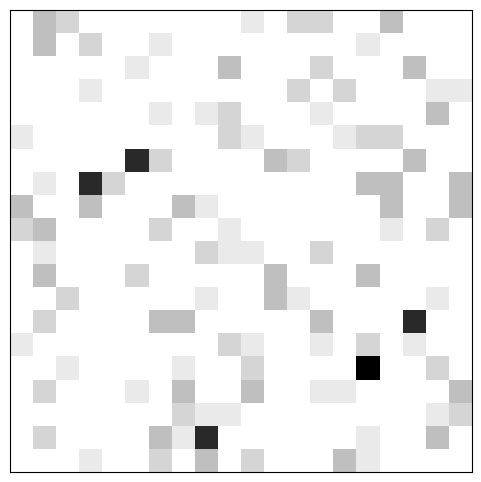

In [17]:
fig, axis = plt.subplots(figsize = (6, 6))
axis.set_xticks([])
axis.set_yticks([])

animationData = all_data.get("Floor") + 10 * all_data.get("Position")

total_steps = len(all_data)
step = max(1, total_steps // 2000)
animationData.iloc[::step].reset_index(drop = True)
agentData = agentData.iloc[::step].reset_index(drop = True)

patch = plt.imshow(animationData[0], cmap = plt.cm.binary)

def animate(frames):
    patch.set_data(animationData[frames])

anim = animation.FuncAnimation(fig, animate, frames = len(animationData))

In [20]:
anim

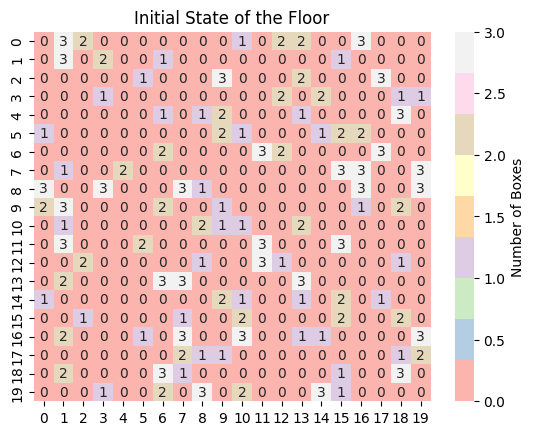

In [18]:
# Initial state of the floor
sns.heatmap(
    all_data.iloc[0]["Floor"],
    annot=True, 
    fmt="g", cmap="Pastel1", 
    cbar_kws={"label": "Number of Boxes"}
)

plt.title("Initial State of the Floor")
plt.show()

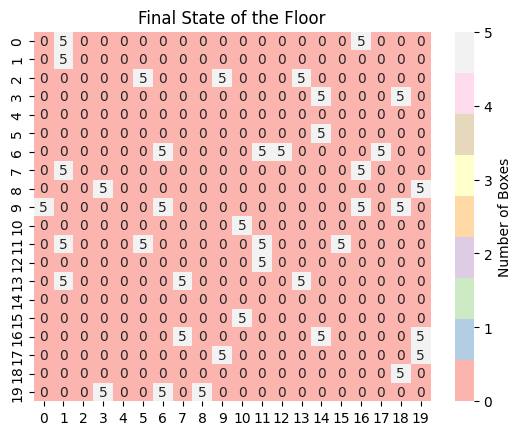

In [19]:
sns.heatmap(
    all_data["Floor"].iloc[model.schedule.steps - 1],
    annot = True,
    fmt = "g",
    cmap = "Pastel1",
    cbar_kws = {"label": "Number of Boxes"}
)

plt.title("Final State of the Floor")
plt.show()

 ### **CONCLUSIÓN FINAL**

La solución implementada se enfoca en diseñar un sistema donde los angetnes de organizadores se desplazan de manera aleatoria por el almacén, cada uno con una variable que indica si actualmente está cargando una caja, respetando la restricción de transportar solo una caja a la vez. Cuando los agnetnes no lleva ninguna caja, examina las 4 celdas adyacentes en busca de los stacks de cajas; si encuentra un stack y la cantidad de cajas en él es menor a 5, procede a cargar una caja. Adicionalmente, tengo una condición especial cuando solo falta un stack para copmletar en la cual el robo solo puede mover cajas de stacks que contengan 1 o 2 cajas. Y para optimizar el proceso, el agente, al tomar una caja, registra la cantidad original de cajas en el stack del que la obtuvo. Mientras carga una caja, el agente se desplaza aleatoriamente por el almacén. 

Durante su movimiento aleatorio, si el agente encuentra en sus 4 celdas adyacentes otro stack de cajas, deposita la caja que transporta en ese stack. Para dejar la caja, el stack debe contener un número de cajas mayor o igual al registro de la cantidad original de cajas en el stack del que se tomó la caja, y el stack debe tener menos de 5 cajas en total. Y así, el agente continúa desplazándose aleatoriamente por el almacén, cargando y depositando cajas, hasta que todas las cajas se encuentren en stacks de 5 unidades cada uno. Mi estrategia se basa en un mecanismo de búsqueda aleatoria de stacks de cajas y en un proceso de depósito en stacks que cumplan con condiciones específicas.

Para reducir el número de pasos en esta solución de organizar el almacén, podría ajustar la lógica del movimiento de los agentes para que se desplacen de manera más efectiva, priorizando direcciones con más cajas cercanas. También, mejorar el algoritmo utilizado por los agentes para colocar las cajas puede acelear el proces. Se podría implmentar un algoritmo más eficiente para la distribución y colocación de cajas puede optimizar el trabajo de los agentes. 

En conclusión, esa actividad integradora fue una oportunidad valiosa para aplicar los conceptos que hemos visto durante la clase en un contexto práctico. Aprendí que ajustar parámetros y utilizar herramientas de perfilado son estrategias efectivas para optimizar el rendimiento de una simulación. Esta actividad me ayudó a mejorar mi comprensión de la simulación basada en agentes.

 ### **LINK AL REPOSITORIO**

https://github.com/yna2131/Organizing_Storage